# analysis V2 - new basis code - Dec 4, 2023
- cleaned up the data QC and organizations a bit
- having two anndata and their spin offs - both FISH and proj data 
- flip an axis (y-axis) when plotting - not in data
- focus on L2/3 cells

TODO: 
- separate and organize plotting functions 
- organize the plots and generate more insights

In [1]:
import numpy as np
import pandas as pd
import os 
import matplotlib.pyplot as plt
import umap
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib

import anndata 

from scroutines import config_plots
from scroutines import basicu
from scroutines import miscu

In [2]:
import sys
sys.setrecursionlimit(10000)
from scipy.cluster import hierarchy as sch

In [3]:
pth_dat = '/u/home/f/f7xiesnm/project-zipursky/easifish/lt172/proc/v1/'
!ls $pth_dat

bad_roi_list.npy  roi_all.csv  roi.csv	spotcount.csv


In [4]:
# features
var_names = {
    'r1_c0': 'Sorcs3',
    'r1_c1': 'Kcnq5',
    'r1_c2': 'Chrm2',
    'r1_c4': 'Adamts2',
    
    'r2_c0': 'Kcnip3',
    'r2_c1': 'Rorb',
    'r2_c2': 'Cdh13',
    'r2_c4': 'Cntn5',
    
    'r3_c0': 'Cdh12',
    'r3_c1': 'Gria3',
    'r3_c2': 'Cntnap2',
    'r3_c4': 'Gabrg3',
    
    'r4_c0': 'Kcnh5',
    'r4_c1': 'RL Cre',
    'r4_c2': 'Slc17a7',
    'r4_c4': 'Grm8',
    
    'r5_c0': 'Ncam2',
    'r5_c1': 'Rfx3',
    'r5_c2': 'Epha10',
    'r5_c4': 'Baz1a',
}
proj_idx = np.array(['r4_c1'])

# cells
f_meta = os.path.join(pth_dat, 'roi.csv')

# spots
f_spot = os.path.join(pth_dat, 'spotcount.csv')

In [5]:
# f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot_v2.csv'
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results/gene_ptime_P28_L23_Mar27.tsv'
df_annot = pd.read_csv(f).sort_values('gene_ptime')

In [6]:

var = pd.Series(var_names).to_frame('name')
var['proj'] = False
var.loc[proj_idx, 'proj'] = True
var['ptime'] = df_annot.set_index('gene').reindex(var['name'])['gene_ptime'].values
# var['ptime_order'] = var['ptime'].rank()  

var_idx = var.index.values.astype(str)
var_i2n = var['name'] 
var_n2i = var.reset_index().set_index('name')['index']

gene_idx = np.array([idx for idx in var_idx if idx not in proj_idx])

# ftrs_order  = gene_names.index.values 
# genes_order = gene_names.values
var

,name,proj,ptime
r1_c0,Sorcs3,False,0.597601
r1_c1,Kcnq5,False,0.602984
r1_c2,Chrm2,False,0.788313
r1_c4,Adamts2,False,0.369528
r2_c0,Kcnip3,False,0.543324
r2_c1,Rorb,False,0.739757
r2_c2,Cdh13,False,0.373281
r2_c4,Cntn5,False,0.516831
r3_c0,Cdh12,False,0.623492
r3_c1,Gria3,False,NaN


In [7]:
meta = pd.read_csv(f_meta, index_col=0)
spot = pd.read_csv(f_spot, index_col=0)
assert np.all(meta.index.values == spot.index.values)
print(meta.shape, spot.shape) # 

max_x, max_y, max_z = meta[['x', 'y', 'z']].describe().loc['max']
min_x, min_y, min_z = meta[['x', 'y', 'z']].describe().loc['min']

meta['to_edge'] = np.minimum(
    np.minimum(meta['x']-min_x, max_x-meta['x']), 
    np.minimum(meta['y']-min_y, max_y-meta['y']), 
    np.minimum(meta['z']-min_z, max_z-meta['z']),
)
meta['cov'] = spot.sum(axis=1)

print(f'x: {min_x:.1f}\t{max_x:.1f}')
print(f'y: {min_y:.1f}\t{max_y:.1f}')
print(f'z: {min_z:.1f}\t{max_z:.1f}')

(6606, 4) (6606, 20)
x: 18.4	416.4
y: 3.0	375.5
z: 5.1	350.4


In [8]:
adata = anndata.AnnData(X=spot.values, obs=meta, var=var)
adata

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 6606 × 20
    obs: 'z', 'y', 'x', 'area', 'to_edge', 'cov'
    var: 'name', 'proj', 'ptime'

In [9]:
# remove outliers adata -> adata2
df = adata.obs
conds = [
    df['area'] > 500,
    df['x'] > min_x + 20,
    df['x'] < max_x - 20,
    
    df['y'] > min_y + 20,
    df['y'] < max_y - 20,
    
    df['z'] > min_z + 20,
    df['z'] < max_z - 20,
]
cond_all = np.ones(len(df)) > 0
for cond in conds:
    cond_all = np.logical_and(cond_all, cond)
    print(cond_all.sum())
print(f"Num cells before and after: {len(df)} -> {cond_all.sum()}")

# remove outliers
adata2 = adata[cond_all].copy()
adata2


6602
6531
6466
6419
6235
6143
6072
Num cells before and after: 6606 -> 6072


AnnData object with n_obs × n_vars = 6072 × 20
    obs: 'z', 'y', 'x', 'area', 'to_edge', 'cov'
    var: 'name', 'proj', 'ptime'

In [10]:
# separate the proj data adata2 -> adata3
adata3 = adata2[:,gene_idx].copy()
adata3.obs[proj_idx] = np.array(adata2[:,proj_idx].X)
adata3.obs['cov_gene'] = np.array(adata3.X.sum(axis=1))
adata2

AnnData object with n_obs × n_vars = 6072 × 20
    obs: 'z', 'y', 'x', 'area', 'to_edge', 'cov'
    var: 'name', 'proj', 'ptime'

In [11]:
def norm_data(adata):
    """This procedure is independnet of each gene
    norm by size (cell volume)
    norm by log2(1+)
    norm by zscore
    """
    # size
    med_size = adata.obs['area'].median()
    max_size = adata.obs['area'].max()
    min_size = adata.obs['area'].min()

    print(f"Med cell size {med_size:.1f} um^3\t  {np.power(med_size,1/3):.1f} um")
    print(f"Max cell size {max_size:.1f} um^3\t  {np.power(max_size,1/3):.1f} um")
    print(f"Min cell size {min_size:.1f} um^3\t  {np.power(min_size,1/3):.1f} um")

    size_factor = (adata.obs['area']/med_size).values


    # norm by size; by log2+1; by zscore
    mat_raw = np.array(adata.X)
    mat_nrm = mat_raw/size_factor.reshape(-1,1) # .divide(size_factor, axis=0)
    mat_log = np.log2(1+mat_nrm)
    mat_zsc = (mat_log - np.mean(mat_log, axis=0))/np.std(mat_log, axis=0)

    adata.layers['nrm'] = mat_nrm
    adata.layers['log'] = mat_log
    adata.layers['zsc'] = mat_zsc
    
    return # mat_raw, mat_nrm, mat_log, mat_zsc

In [12]:
norm_data(adata2)
norm_data(adata3)

Med cell size 2017.7 um^3	  12.6 um
Max cell size 7912.5 um^3	  19.9 um
Min cell size 501.9 um^3	  7.9 um
Med cell size 2017.7 um^3	  12.6 um
Max cell size 7912.5 um^3	  19.9 um
Min cell size 501.9 um^3	  7.9 um


In [13]:
var_idx

array(['r1_c0', 'r1_c1', 'r1_c2', 'r1_c4', 'r2_c0', 'r2_c1', 'r2_c2',
       'r2_c4', 'r3_c0', 'r3_c1', 'r3_c2', 'r3_c4', 'r4_c0', 'r4_c1',
       'r4_c2', 'r4_c4', 'r5_c0', 'r5_c1', 'r5_c2', 'r5_c4'], dtype='<U5')

In [14]:
# cols
raw_var_idx = np.char.add(var_idx, '_raw')
nrm_var_idx = np.char.add(var_idx, '_nrm')
log_var_idx = np.char.add(var_idx, '_log')
zsc_var_idx = np.char.add(var_idx, '_zsc')

raw_gene_idx = np.char.add(gene_idx, '_raw')
nrm_gene_idx = np.char.add(gene_idx, '_nrm')
log_gene_idx = np.char.add(gene_idx, '_log')
zsc_gene_idx = np.char.add(gene_idx, '_zsc')

# binary analysis
bins_8p = np.linspace(0,400,8+1).astype(int)
bins_4p = np.linspace(0,400,4+1).astype(int)
print(bins_8p, bins_4p)

[  0  50 100 150 200 250 300 350 400] [  0 100 200 300 400]


# to be used later

In [15]:
adata2.obs['xb_8p'] = pd.cut(adata2.obs['x'], bins=bins_8p)
adata2.obs['yb_8p'] = pd.cut(adata2.obs['y'], bins=bins_8p)
adata2.obs['zb_8p'] = pd.cut(adata2.obs['z'], bins=bins_8p)

adata2.obs['xb_4p'] = pd.cut(adata2.obs['x'], bins=bins_4p)
adata2.obs['yb_4p'] = pd.cut(adata2.obs['y'], bins=bins_4p)
adata2.obs['zb_4p'] = pd.cut(adata2.obs['z'], bins=bins_4p)


In [16]:
adata3.obs['xb_8p'] = pd.cut(adata3.obs['x'], bins=bins_8p)
adata3.obs['yb_8p'] = pd.cut(adata3.obs['y'], bins=bins_8p)
adata3.obs['zb_8p'] = pd.cut(adata3.obs['z'], bins=bins_8p)

adata3.obs['xb_4p'] = pd.cut(adata3.obs['x'], bins=bins_4p)
adata3.obs['yb_4p'] = pd.cut(adata3.obs['y'], bins=bins_4p)
adata3.obs['zb_4p'] = pd.cut(adata3.obs['z'], bins=bins_4p)


In [17]:

df_p2 = adata2.obs.copy()
df_p2[nrm_var_idx] = np.array(adata2.layers['nrm'])

df_p3 = adata3.obs.copy()
df_p3[nrm_gene_idx] = np.array(adata3.layers['nrm'])

# report 

In [18]:
for idx in var_idx:
    val = adata[:,idx].X[:,0]
    print(f'{idx}\t{var_i2n.loc[idx]}\t{np.min(val):.1f}\t{np.max(val):.1f}\t{100*np.sum(val>0)/len(val):.2f}%')

r1_c0	Sorcs3	0.0	81.0	78.38%
r1_c1	Kcnq5	0.0	183.0	99.29%
r1_c2	Chrm2	0.0	67.0	71.04%
r1_c4	Adamts2	0.0	30.0	36.10%
r2_c0	Kcnip3	0.0	259.0	97.29%
r2_c1	Rorb	0.0	210.0	94.67%
r2_c2	Cdh13	0.0	117.0	76.67%
r2_c4	Cntn5	0.0	43.0	65.11%
r3_c0	Cdh12	0.0	132.0	99.53%
r3_c1	Gria3	0.0	253.0	98.20%
r3_c2	Cntnap2	0.0	79.0	93.37%
r3_c4	Gabrg3	0.0	33.0	64.40%
r4_c0	Kcnh5	0.0	251.0	97.87%
r4_c1	RL Cre	0.0	327.0	87.90%
r4_c2	Slc17a7	0.0	448.0	99.12%
r4_c4	Grm8	0.0	80.0	71.47%
r5_c0	Ncam2	0.0	156.0	98.37%
r5_c1	Rfx3	0.0	133.0	97.62%
r5_c2	Epha10	0.0	103.0	98.80%
r5_c4	Baz1a	0.0	34.0	25.86%


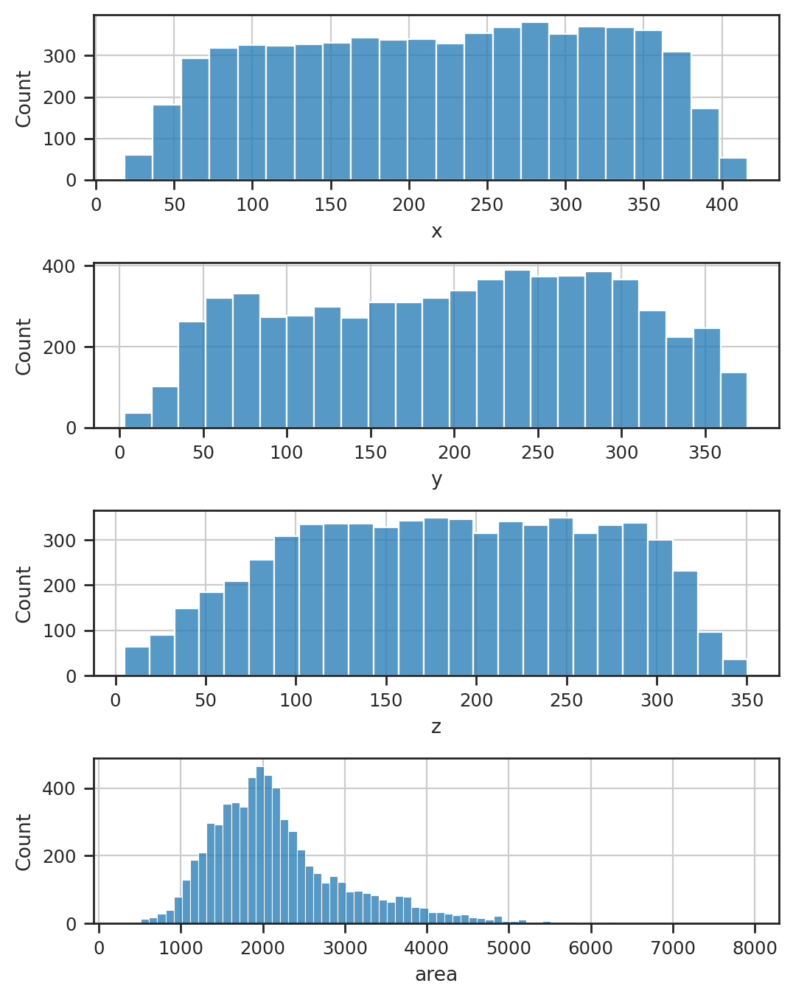

In [19]:
cols = ['x', 'y', 'z', 'area']
with sns.plotting_context('paper'):
    fig, axs = plt.subplots(4, 1, figsize=(1*6, 2*4))
    for ax, col in zip(axs, cols):
        sns.histplot(adata.obs[col], ax=ax)
        ax.set_xlabel(col)
    fig.subplots_adjust(hspace=0.5)
    plt.show()


<Axes: xlabel='area', ylabel='cov'>

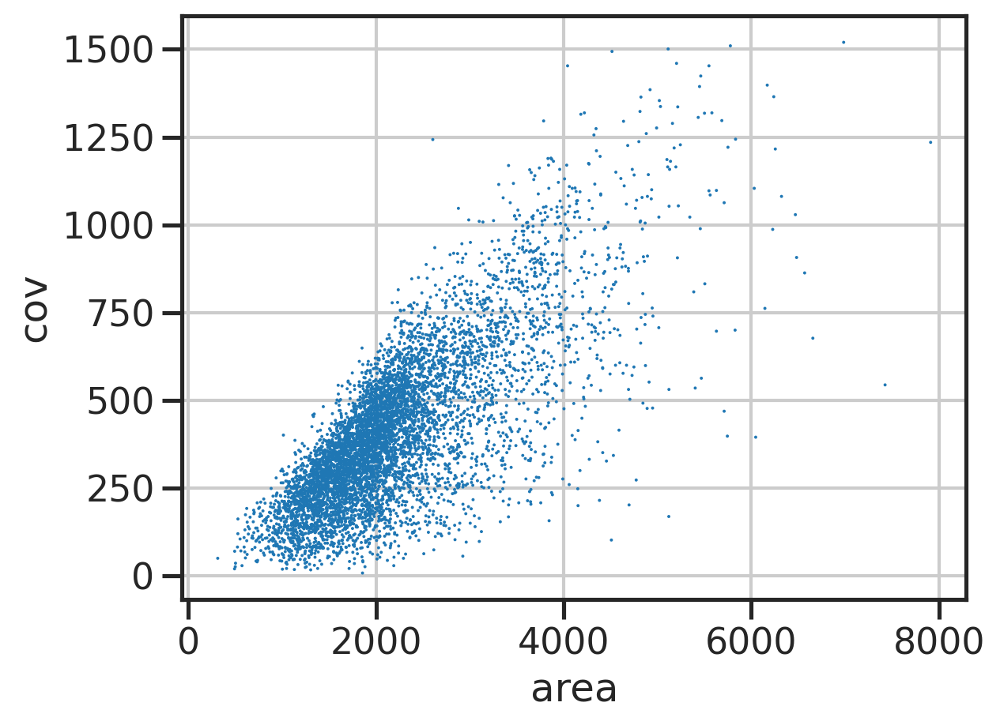

In [20]:
sns.scatterplot(data=adata.obs, x='area', y='cov', s=2, edgecolor='none')

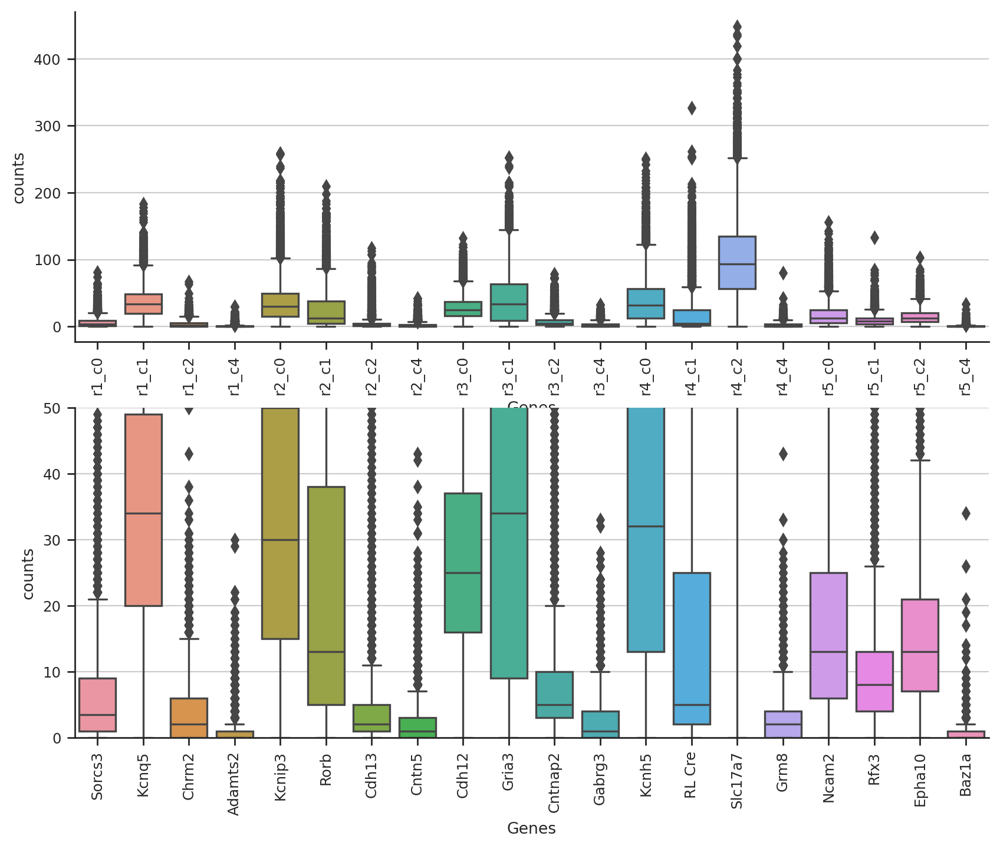

In [21]:
with sns.plotting_context('paper'):
    fig, axs = plt.subplots(2, 1, figsize=(10*1,4*2))
    ax = axs[0]
    sns.boxplot(data=adata.X, ax=ax)
    ax.set_xticklabels(adata.var.index.values, rotation=90) 
    ax.set_ylabel('counts')
    ax.set_xlabel('Genes')
    sns.despine(ax=ax)

    ax = axs[1]
    sns.boxplot(data=adata.X, ax=ax)
    ax.set_xticklabels(adata.var['name'].values, rotation=90)
    sns.despine(ax=ax)
    ax.set_ylim([0,50])
    ax.set_ylabel('counts')
    ax.set_xlabel('Genes')

<Axes: xlabel='area', ylabel='cov'>

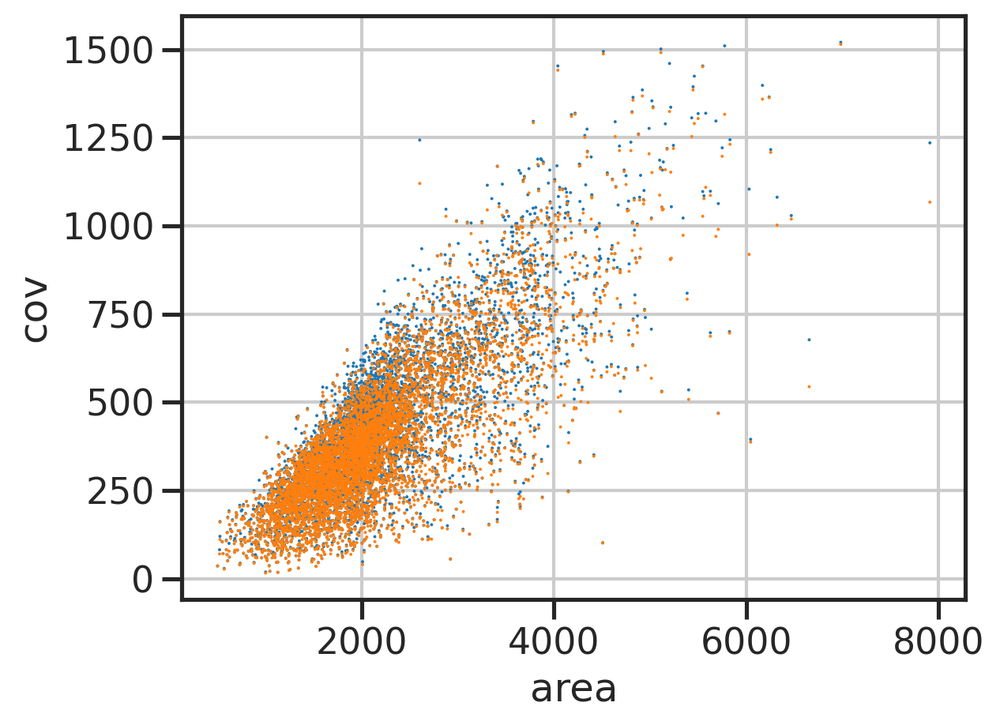

In [22]:
sns.scatterplot(data=adata3.obs, x='area', y='cov', s=2, edgecolor='none')
sns.scatterplot(data=adata3.obs, x='area', y='cov_gene', s=2, edgecolor='none')

<Axes: xlabel='area', ylabel='r4_c1'>

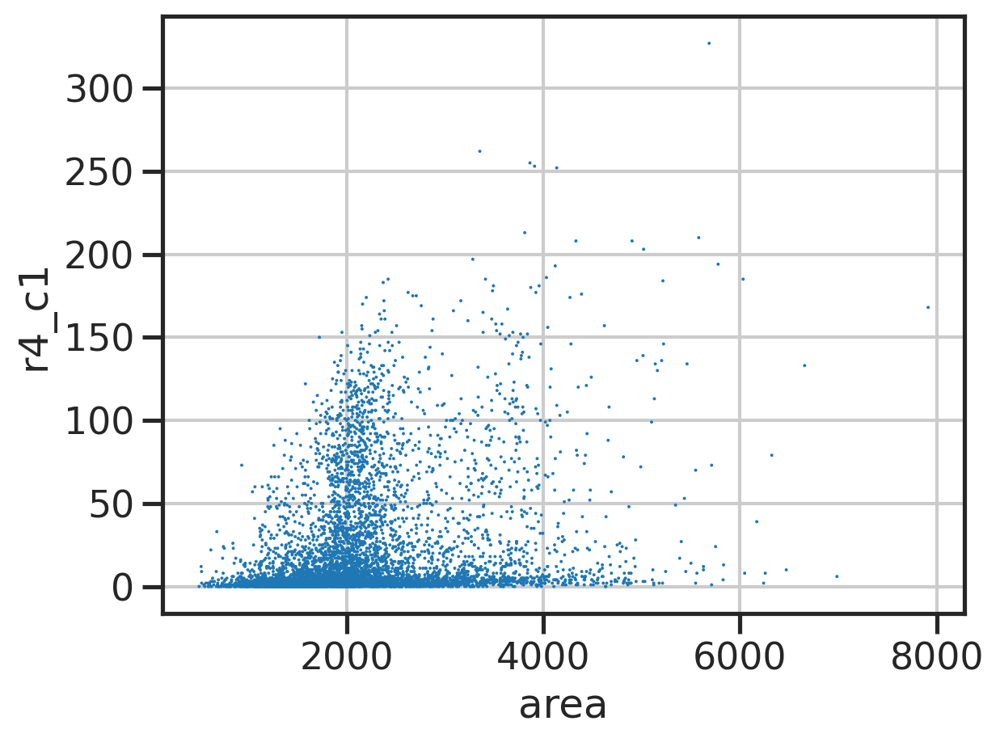

In [23]:
sns.scatterplot(data=adata3.obs, x='area', y=proj_idx[0], s=2, edgecolor='none')

In [24]:
# # PCAs
# n_pc = len(genes_order)
# idx_pcs = np.arange(1, n_pc+1)

# pca = PCA(n_components=n_pc)
# pcs = pca.fit_transform(mat_zscore) 
# plt.plot(idx_pcs, pca.explained_variance_ratio_, 'o')
# plt.xticks(idx_pcs)
# plt.ylim(ymin=0)
# plt.axhline(1/n_pc, color='k')
# plt.xlabel('PC')
# plt.ylabel('Explained variance')

# for i in idx_pcs:
#     dfnew[f'PC{i}'] = pcs[:,i-1]

In [25]:
# # UMAPs
# Zspace = umap.UMAP(n_components=2).fit_transform(pcs)
# dfnew['umap_x'] = Zspace[:,0]
# dfnew['umap_y'] = Zspace[:,1]

# # UMAPs more
# nns = [30, 60, 120, 240, 480]
# for nn in nns:
#     Zspace = umap.UMAP(n_components=2, n_neighbors=nn).fit_transform(pcs)
#     dfnew[f'umap_x_nn{nn}'] = Zspace[:,0]
#     dfnew[f'umap_y_nn{nn}'] = Zspace[:,1]

# # clsts
# numclsts = [2, 5, 10]
# for k in numclsts: 
#     model = KMeans(n_clusters=k)
#     clsts = model.fit_predict(pcs)
#     dfnew[f'clsts_k{k}'] = np.char.add("c", clsts.astype(str))

# # clsts
# G = miscu.build_feature_graph_knnlite(pcs, k=15, metric='euclidean')
# rs = [0.01, 0.02, 0.05, 0.1, 1]
# for r in rs:
#     clsts = miscu.leiden(G, dfnew.index.values, resolution=r) 
#     dfnew[f'clsts_r{r}'] = np.char.add("c", np.array(clsts).astype(str))

# check basics
- y: pia-ventricular axis

# z-sectioning visuals
- bin into zbin
- plot for each zbin

In [26]:
def gen_palette(dfnew, col):
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
    return palette

In [27]:
def view_z_sections(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0, flip_y=False):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    if flip_y: 
        axs.flat[0].invert_yaxis()
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('zb_8p')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=10, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=10, c='gray', 
                           edgecolor='none', 
                          )
            
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [28]:
def view_z_sections_4panels(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0, flip_y=False):
    """
    """
    # assert len(dfnew['bins_zb_4p'].unique())-1 == 4 # 4 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(1, 4, figsize=(4*4,1*4), sharex=True, sharey=True)
    if flip_y: 
        axs.flat[0].invert_yaxis()
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('zb_4p')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=8, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=8, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i == 0:
            ax.set_ylabel(sp_y)
        ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [29]:
def view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None, flip_y=False):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    if palette is None:
        palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    if flip_y: 
        axs.flat[0].invert_yaxis()
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('zb_8p')):
        ax = axs.flat[i]
        ax.grid(False)
        if i == 4-1:
            legend = True
        else:
            legend = False
        g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col, 
                            hue_order=hue_order, palette=palette,
                            s=10, 
                            edgecolor='none', 
                            ax=ax,
                            legend=legend,
                          )
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)
        if i == 4-1:
            ax.legend(bbox_to_anchor=(1,1))

    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

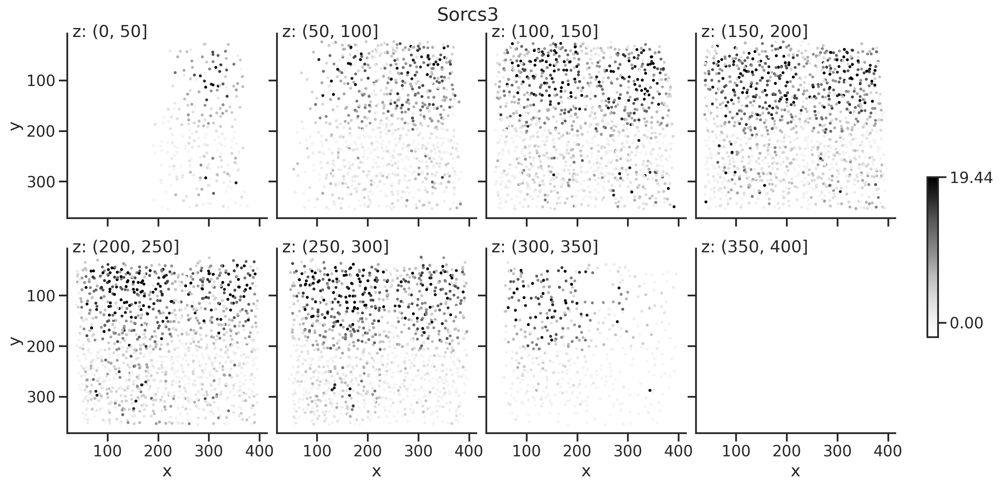

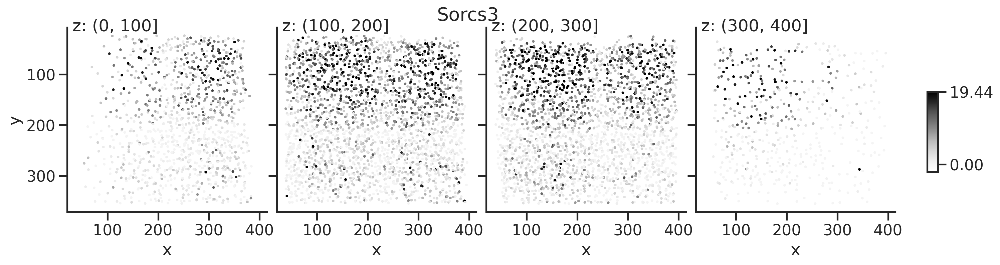

In [30]:
sp_x, sp_y = 'x', 'y'
col = gene_idx[0] # ftrs_order[0]
title = var_i2n[col]

view_z_sections(df_p2, sp_x, sp_y, col=col+'_nrm', cmap='Greys', title=title, flip_y=True)
view_z_sections_4panels(df_p2, sp_x, sp_y, col=col+'_nrm', cmap='Greys', title=title, flip_y=True)

# hierarchical clustering

In [31]:
def gen_discrete_colors(N):
    """
    """
    fig, ax = plt.subplots(figsize=(6, 1))
    fig.subplots_adjust(bottom=0.5)
    cmap = matplotlib.cm.jet
    norm = matplotlib.colors.BoundaryNorm(1+np.arange(N), cmap.N, extend='max')
    dismap = matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap)
    fig.colorbar(dismap,
                 cax=ax, orientation='horizontal')
    plt.show()
    
    palette = {i: dismap.to_rgba(i)[:3] for i in 1+np.arange(N)}
    plt.figure(figsize=(5,1))
    plt.scatter(1+np.arange(N), [0]*N, c=[palette[p] for p in palette.keys()])
    plt.show()
    return palette, dismap

(6072,) (5,)
(6072,) (12,)
(6072,) (25,)


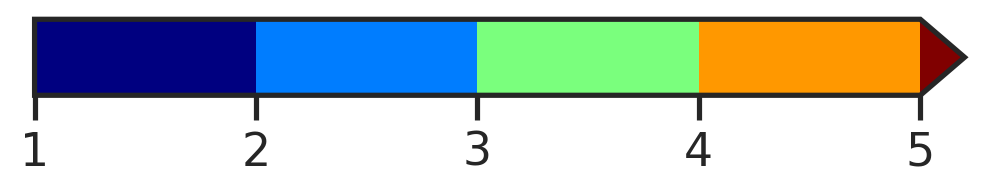

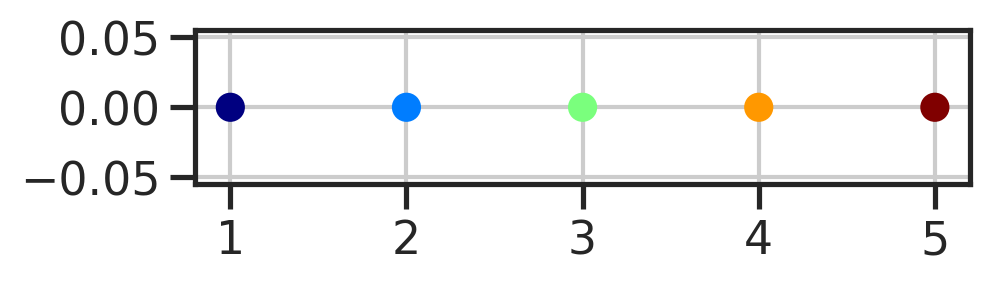

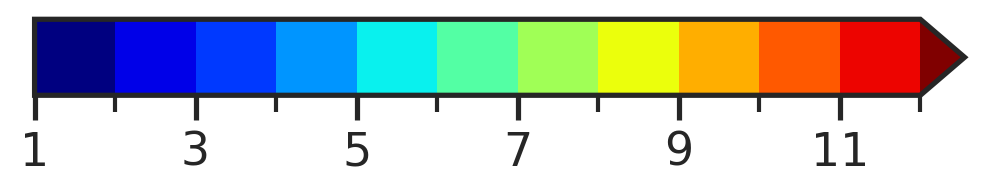

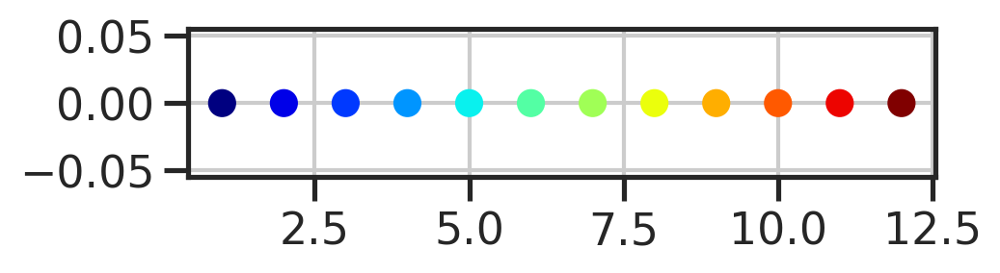

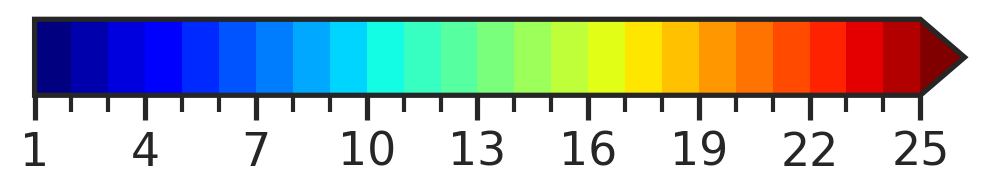

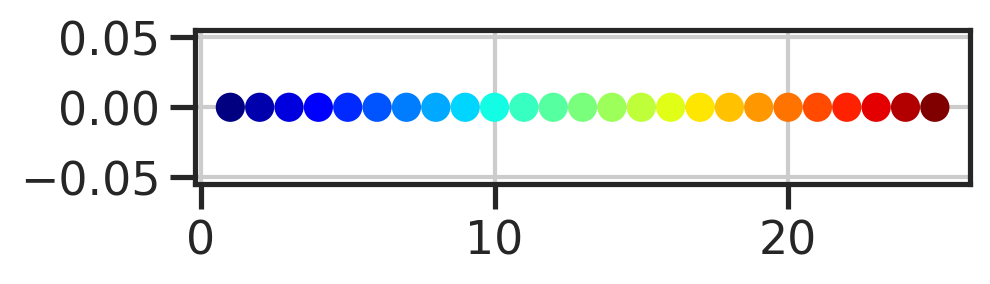

In [32]:
mat_ftrs = pd.DataFrame(adata3.layers['zsc'], index=adata3.obs.index, columns=adata3.var.index)
mat_prjs = adata3.obs[proj_idx] 

# sch
col_link = sch.linkage(mat_ftrs.T, method='ward', metric='euclidean')
col_order = sch.dendrogram(col_link, no_plot=True)['leaves']

row_link = sch.linkage(mat_ftrs, method='ward', metric='euclidean')
row_order = sch.dendrogram(row_link, p=30, truncate_mode='none', no_plot=True)['leaves']

# get clusters
clsts1 = sch.fcluster(row_link, 100, criterion='distance')
clsts2 = sch.fcluster(row_link,  50, criterion='distance')
clsts3 = sch.fcluster(row_link,  30, criterion='distance')

print(clsts1.shape, np.unique(clsts1).shape)
print(clsts2.shape, np.unique(clsts2).shape)
print(clsts3.shape, np.unique(clsts3).shape)


# register
adata3.obs['clst_l1'] = clsts1
adata3.obs['clst_l2'] = clsts2
adata3.obs['clst_l3'] = clsts3

adata2.obs['clst_l1'] = clsts1
adata2.obs['clst_l2'] = clsts2
adata2.obs['clst_l3'] = clsts3


df_p3['clst_l1'] = clsts1
df_p3['clst_l2'] = clsts2
df_p3['clst_l3'] = clsts3

df_p2['clst_l1'] = clsts1
df_p2['clst_l2'] = clsts2
df_p2['clst_l3'] = clsts3

# colors
palette1, dismap1 = gen_discrete_colors(len(np.unique(clsts1)))
palette2, dismap2 = gen_discrete_colors(len(np.unique(clsts2)))
palette3, dismap3 = gen_discrete_colors(len(np.unique(clsts3)))

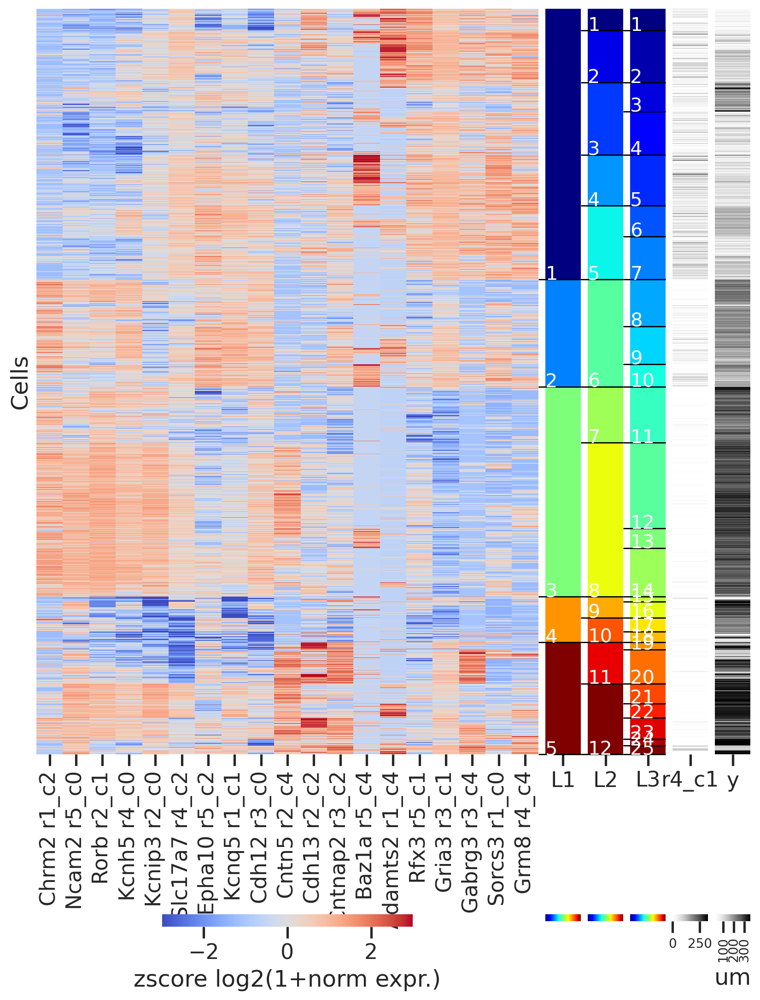

In [33]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*12+"BCDEF")
ax = axd["A"]
col_idx = mat_ftrs.columns[col_order].values.astype(str)
col_names = var_i2n[col_idx].values.astype(str)
xticklabels = np.char.add(np.char.add(col_names, ' '), col_idx)

sns.heatmap(
    mat_ftrs.iloc[row_order,col_order],
    yticklabels=False,
    xticklabels=xticklabels,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+norm expr.)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')
# ax.set_xticklabels()

for i, (ax, col) in enumerate(zip(
    (axd["B"], axd["C"], axd["D"]),
    ('clst_l1', 'clst_l2', 'clst_l3'),
    )):
    vec = adata3.obs[col].values
    sns.heatmap(
        adata3.obs[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label='', ticks=[]),
        ax=ax,
    )
    ax.set_ylabel('')
    positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    for i, pos in enumerate(positions):
        ax.text(0, pos, i+1, color='white', fontsize=15)

ax = axd["E"]
g = sns.heatmap(
    mat_prjs.iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, ),
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10)  # Set fontsize to 12 points

ax = axd["F"]
g = sns.heatmap(
    adata3.obs[['y']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10, rotation=90)  # Set fontsize to 12 points


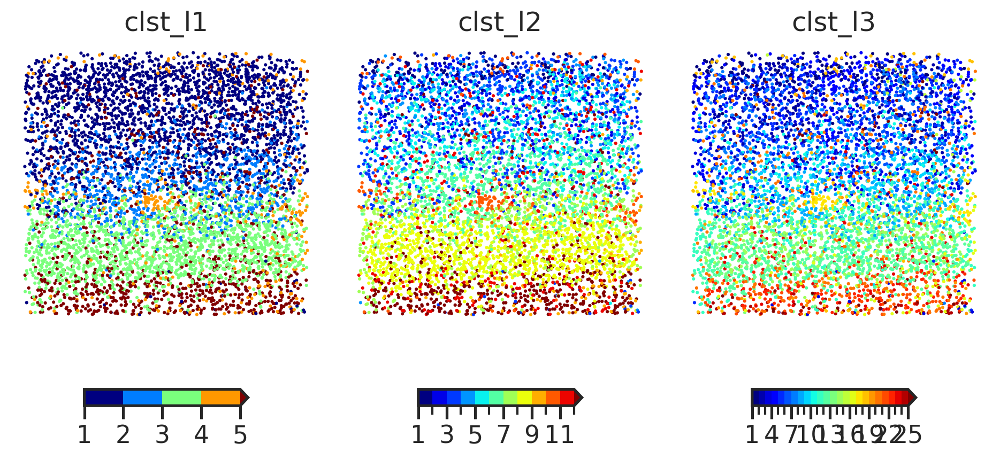

In [34]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(1,3,figsize=(4*3,5*1), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
# cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, palette, dismap, ax) in enumerate(zip(['clst_l1', 'clst_l2', 'clst_l3'], 
                                                   [ palette1,  palette2,  palette3],
                                                   [ dismap1,   dismap2,   dismap3],
                                                   axs.flat)):
    x = adata3.obs[sp_x].values
    y = adata3.obs[sp_y].values
    c = adata3.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=pd.Series(palette)[c], s=5, edgecolor='none',)
    sns.despine(ax=ax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.colorbar(dismap, ax=ax, orientation='horizontal', shrink=0.5, aspect=10)
    
fig.subplots_adjust(hspace=0.1, wspace=0.02)

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1062: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


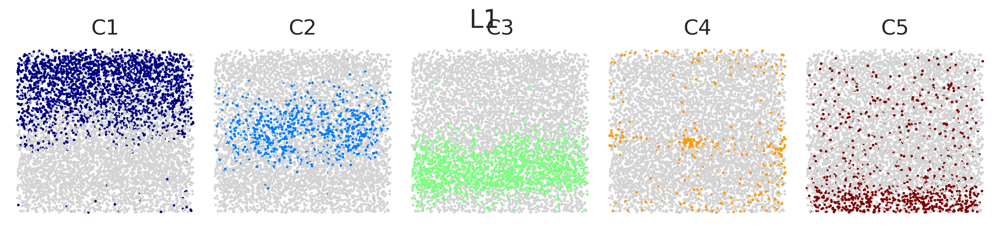

In [35]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l1'
palette = palette1
dismap = dismap1
n = len(adata3.obs[col].unique())
nx = min(6,n)
ny = int((n+nx-1)/nx)
suptitle = 'L1'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
for i, ax in enumerate(axs.flat):
    x = adata3.obs[sp_x].values
    y = adata3.obs[sp_y].values
    c = adata3.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

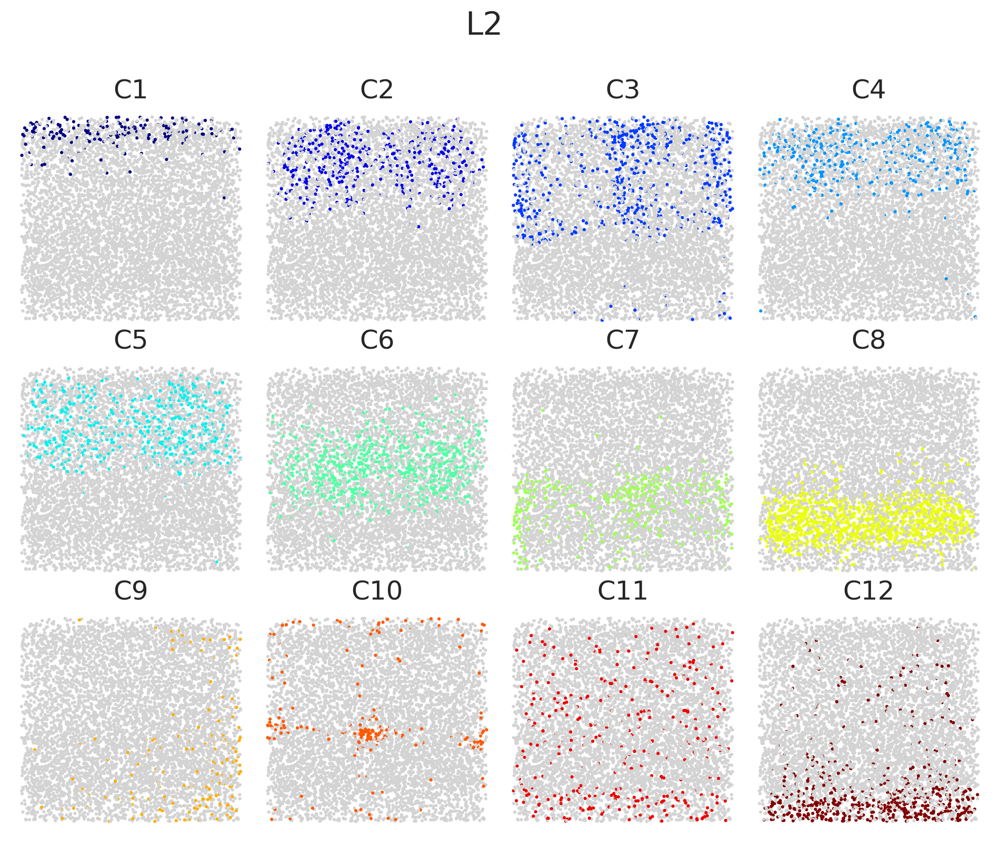

In [36]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l2'
palette = palette2
dismap = dismap2
n = len(adata3.obs[col].unique())
nx = min(4,n)
ny = int((n+nx-1)/nx)
suptitle = 'L2'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
for i, ax in enumerate(axs.flat):
    x = adata3.obs[sp_x].values
    y = adata3.obs[sp_y].values
    c = adata3.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

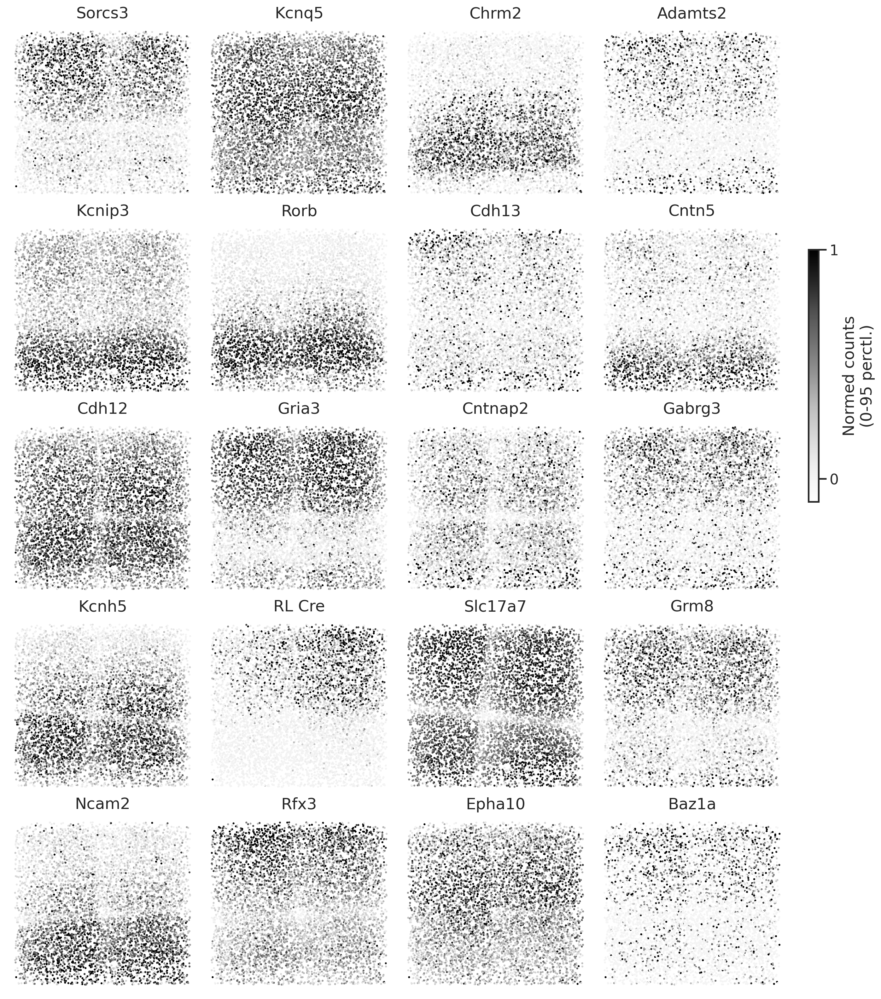

In [37]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(5,4,figsize=(4*4,4*5), sharey=True, sharex=True)
cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
axs.flat[0].invert_yaxis()
for i, (col, ax) in enumerate(zip(var_idx, axs.flat)):
    x = df_p2[sp_x].values
    y = df_p2[sp_y].values
    c = df_p2[col+'_nrm'].values
    vmax=np.percentile(c, 95)
    
    ax.axis('off')
    ax.grid(False)
    g = ax.scatter(x, y, c=c/vmax, s=5, edgecolor='none', cmap='Greys', vmax=1, vmin=-0.1) #vmax, vmin=-0.1*vmax)
    sns.despine(ax=ax)
    ax.set_title(var_i2n[col])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    
fig.colorbar(g, cax=cbar_ax, label='Normed counts\n(0-95 perctl.)', aspect=5, shrink=0.3, ticks=[0, 1])
fig.subplots_adjust(hspace=0.1, wspace=0.02)

<Axes: xlabel='clst_l2'>

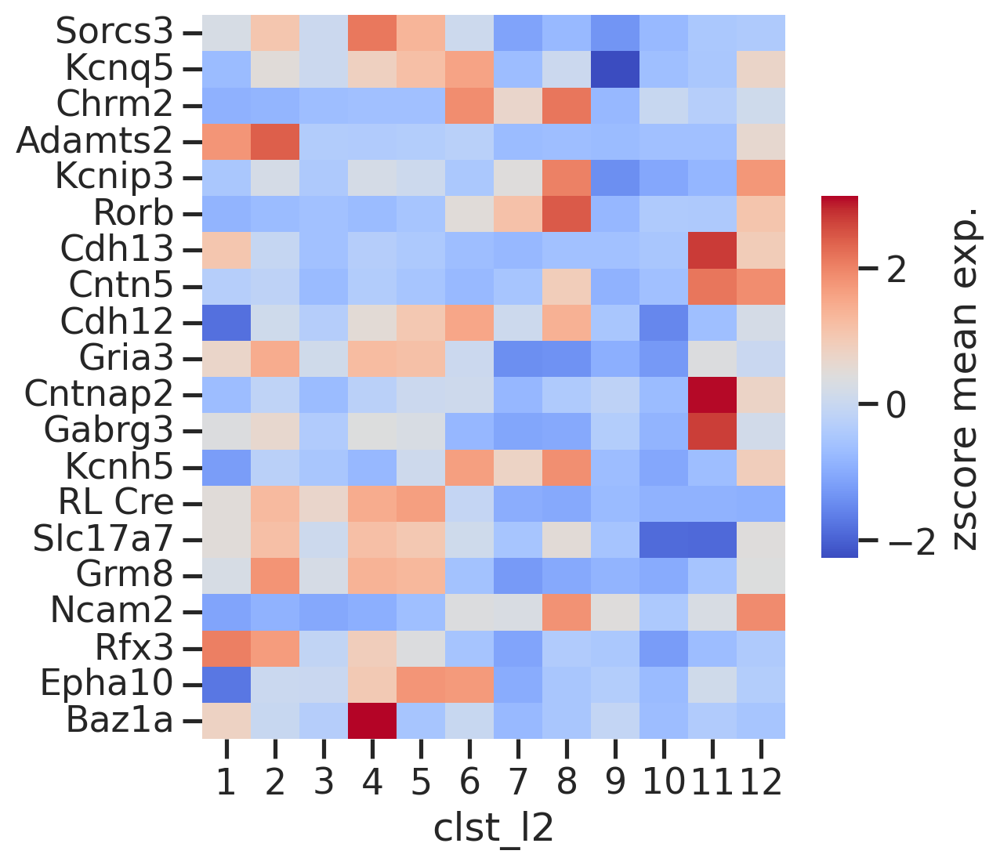

In [38]:
group = 'clst_l2'
dfmean = df_p2.groupby(group)[np.char.add(var_idx, '_nrm')].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,6))
sns.heatmap(dfmean.T, ax=ax, 
            yticklabels=var_i2n[var_idx], 
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

# remove outlier cells and redo

In [39]:
remove_these = [3,7,8,9,10,11,12]
adata2v2 = adata2[~adata2.obs['clst_l2'].isin(remove_these)].copy()
adata3v2 = adata3[~adata3.obs['clst_l2'].isin(remove_these)].copy()
df_p2v2  =  df_p2[~adata2.obs['clst_l2'].isin(remove_these)].copy()
df_p3v2  =  df_p3[~adata3.obs['clst_l2'].isin(remove_these)].copy()

print(adata2v2.shape, adata3v2.shape)

(2489, 20) (2489, 19)


(2489,) (2,)
(2489,) (5,)
(2489,) (8,)


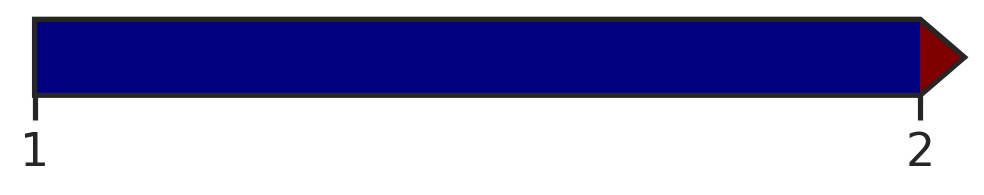

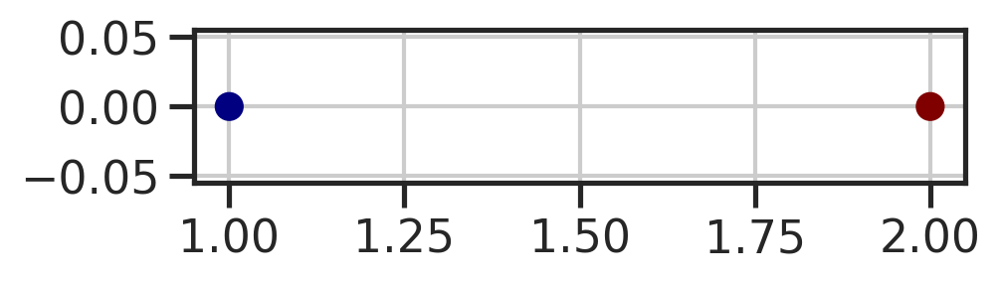

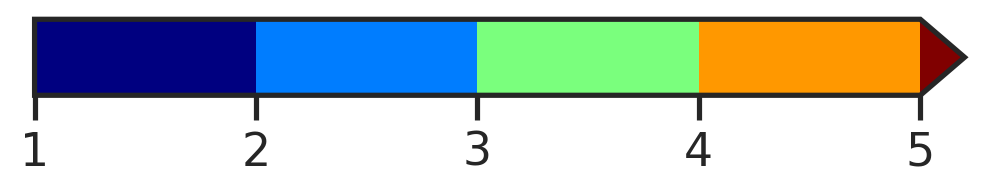

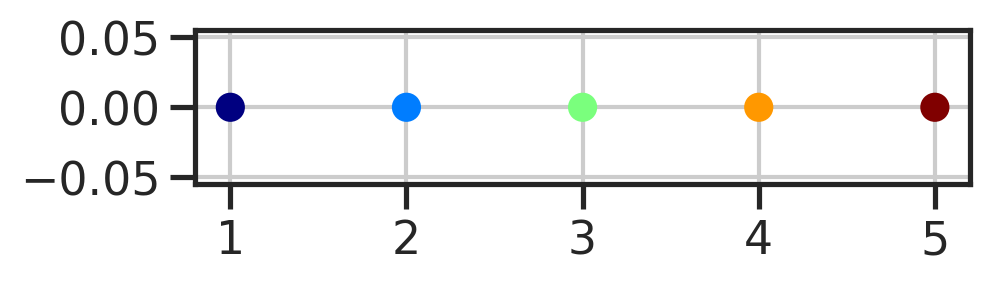

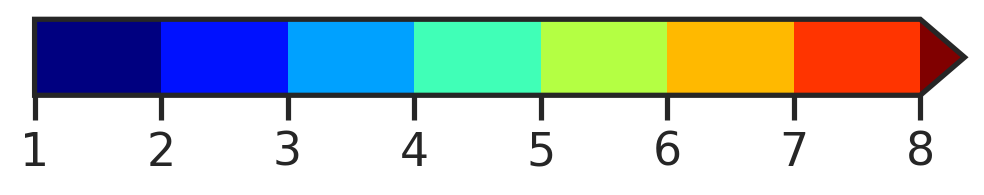

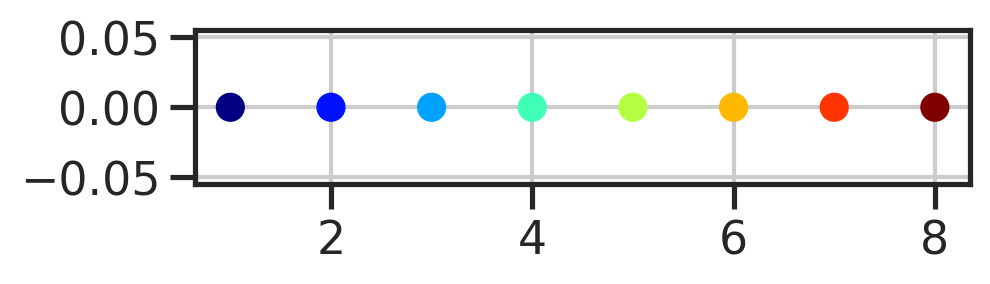

In [40]:
mat_ftrs = pd.DataFrame(adata3v2.layers['zsc'], index=adata3v2.obs.index, columns=adata3v2.var.index)
mat_prjs = adata3v2.obs[proj_idx] 

# sch
col_link = sch.linkage(mat_ftrs.T, method='ward', metric='euclidean')
col_order = sch.dendrogram(col_link, no_plot=True)['leaves']

row_link = sch.linkage(mat_ftrs, method='ward', metric='euclidean')
row_order = sch.dendrogram(row_link, p=30, truncate_mode='none', no_plot=True)['leaves']

# get clusters
clsts1 = sch.fcluster(row_link, 100, criterion='distance')
clsts2 = sch.fcluster(row_link,  50, criterion='distance')
clsts3 = sch.fcluster(row_link,  30, criterion='distance')

print(clsts1.shape, np.unique(clsts1).shape)
print(clsts2.shape, np.unique(clsts2).shape)
print(clsts3.shape, np.unique(clsts3).shape)


# register
adata3v2.obs['clst_l1'] = clsts1
adata3v2.obs['clst_l2'] = clsts2
adata3v2.obs['clst_l3'] = clsts3

adata2v2.obs['clst_l1'] = clsts1
adata2v2.obs['clst_l2'] = clsts2
adata2v2.obs['clst_l3'] = clsts3


df_p3v2['clst_l1'] = clsts1
df_p3v2['clst_l2'] = clsts2
df_p3v2['clst_l3'] = clsts3

df_p2v2['clst_l1'] = clsts1
df_p2v2['clst_l2'] = clsts2
df_p2v2['clst_l3'] = clsts3

# colors
palette1, dismap1 = gen_discrete_colors(len(np.unique(clsts1)))
palette2, dismap2 = gen_discrete_colors(len(np.unique(clsts2)))
palette3, dismap3 = gen_discrete_colors(len(np.unique(clsts3)))

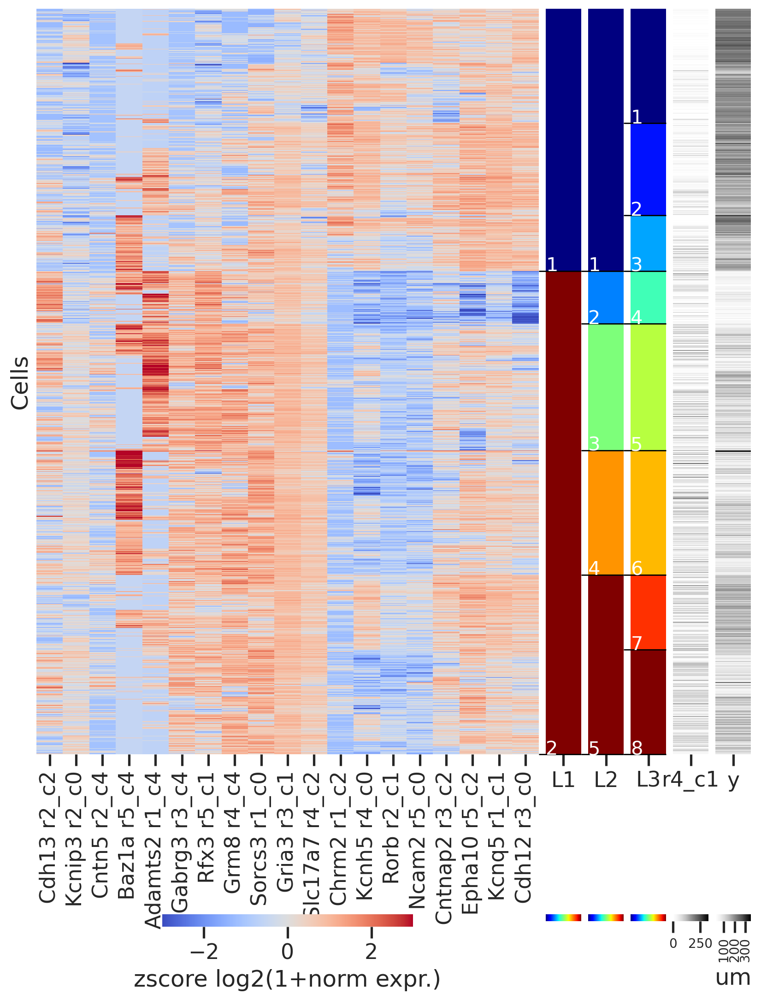

In [41]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*12+"BCDEF")
ax = axd["A"]
col_idx = mat_ftrs.columns[col_order].values.astype(str)
col_names = var_i2n[col_idx].values.astype(str)
xticklabels = np.char.add(np.char.add(col_names, ' '), col_idx)

sns.heatmap(
    mat_ftrs.iloc[row_order,col_order],
    yticklabels=False,
    xticklabels=xticklabels,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+norm expr.)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')
# ax.set_xticklabels()

for i, (ax, col) in enumerate(zip(
    (axd["B"], axd["C"], axd["D"]),
    ('clst_l1', 'clst_l2', 'clst_l3'),
    )):
    vec = adata3v2.obs[col].values
    sns.heatmap(
        adata3v2.obs[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label='', ticks=[]),
        ax=ax,
    )
    ax.set_ylabel('')
    positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    for i, pos in enumerate(positions):
        ax.text(0, pos, i+1, color='white', fontsize=15)

ax = axd["E"]
g = sns.heatmap(
    mat_prjs.iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, ),
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10)  # Set fontsize to 12 points

ax = axd["F"]
g = sns.heatmap(
    adata3v2.obs[['y']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10, rotation=90)  # Set fontsize to 12 points


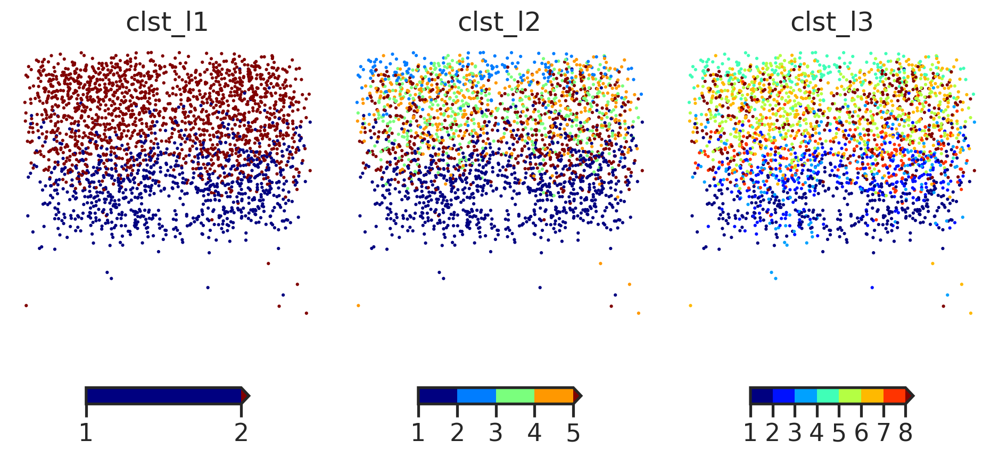

In [42]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(1,3,figsize=(4*3,5*1), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
# cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, palette, dismap, ax) in enumerate(zip(['clst_l1', 'clst_l2', 'clst_l3'], 
                                                   [ palette1,  palette2,  palette3],
                                                   [ dismap1,   dismap2,   dismap3],
                                                   axs.flat)):
    x = adata3v2.obs[sp_x].values
    y = adata3v2.obs[sp_y].values
    c = adata3v2.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=pd.Series(palette)[c], s=5, edgecolor='none',)
    sns.despine(ax=ax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.colorbar(dismap, ax=ax, orientation='horizontal', shrink=0.5, aspect=10)
    
fig.subplots_adjust(hspace=0.1, wspace=0.02)

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1062: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


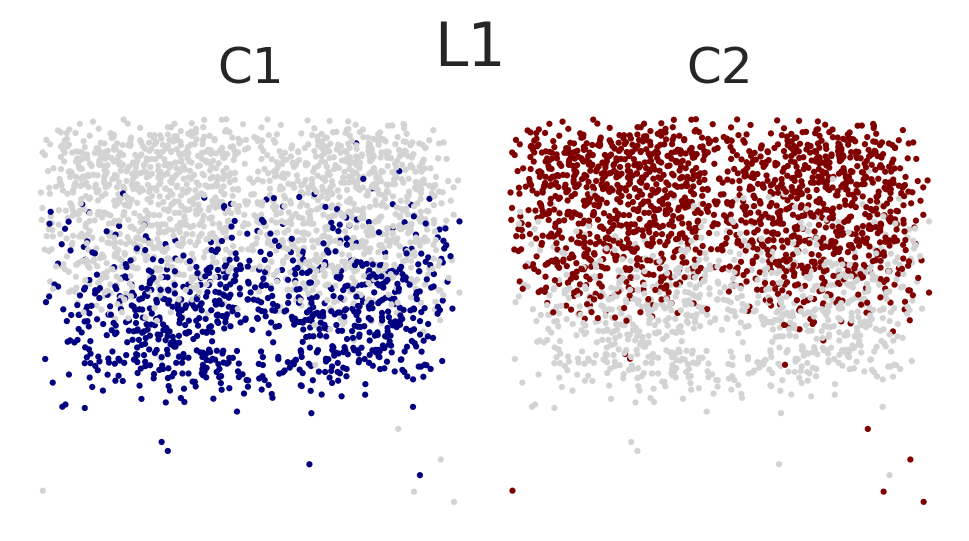

In [43]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l1'
palette = palette1
dismap = dismap1
n = len(adata3v2.obs[col].unique())
nx = min(6,n)
ny = int((n+nx-1)/nx)
suptitle = 'L1'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
for i, ax in enumerate(axs.flat):
    x = adata3v2.obs[sp_x].values
    y = adata3v2.obs[sp_y].values
    c = adata3v2.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

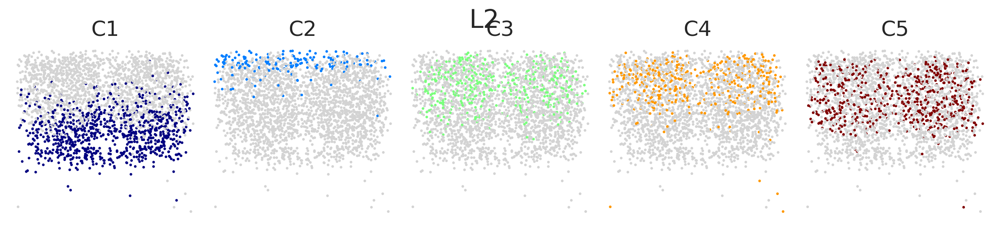

In [44]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l2'
palette = palette2
dismap = dismap2
n = len(adata3v2.obs[col].unique())
nx = min(5,n)
ny = int((n+nx-1)/nx)
suptitle = 'L2'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
axs.flat[0].invert_yaxis()
for i, ax in enumerate(axs.flat):
    x = adata3v2.obs[sp_x].values
    y = adata3v2.obs[sp_y].values
    c = adata3v2.obs[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

In [45]:
var_oidx = np.argsort(var['ptime'].values)
var_order = var_i2n[var_idx[var_oidx]]
var_order

r1_c4    Adamts2
r2_c2      Cdh13
r3_c4     Gabrg3
r4_c4       Grm8
r2_c4      Cntn5
r5_c1       Rfx3
r2_c0     Kcnip3
r5_c4      Baz1a
r1_c0     Sorcs3
r1_c1      Kcnq5
r3_c2    Cntnap2
r3_c0      Cdh12
r4_c0      Kcnh5
r5_c2     Epha10
r5_c0      Ncam2
r2_c1       Rorb
r1_c2      Chrm2
r4_c1     RL Cre
r4_c2    Slc17a7
r3_c1      Gria3
Name: name, dtype: object

In [46]:
var_order_manual = pd.Series({
    'r2_c2': 'Cdh13',
    'r1_c4': 'Adamts2',
    'r5_c1': 'Rfx3',
    'r2_c4': 'Cntn5',
    
    'r3_c4': 'Gabrg3',
    'r4_c4': 'Grm8',
    
    'r2_c0': 'Kcnip3',
    'r5_c4': 'Baz1a',
    'r1_c0': 'Sorcs3',
    'r1_c1': 'Kcnq5',
    'r3_c2': 'Cntnap2',
    
    'r3_c0': 'Cdh12',
    'r5_c2': 'Epha10',
    'r4_c0': 'Kcnh5',
    
    'r5_c0': 'Ncam2',
    'r1_c2': 'Chrm2',
    'r2_c1': 'Rorb',
    
    'r3_c1': 'Gria3',
    'r4_c2': 'Slc17a7',
    'r4_c1': 'RL Cre',
    
})
clst_order_manual = [2,3,4,5,1]

<Axes: xlabel='clst_l2'>

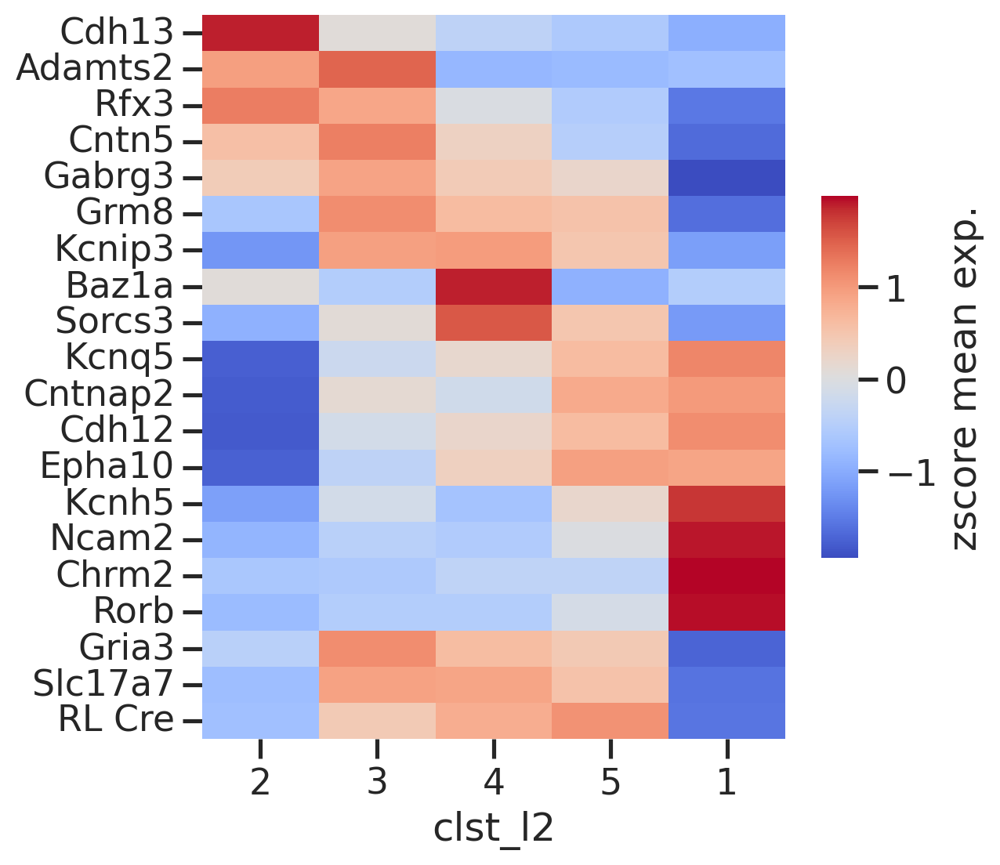

In [47]:
group = 'clst_l2'
dfmean = df_p2v2.groupby(group)[np.char.add(var_order_manual.index.values.astype(str), '_nrm')].mean()
dfmean = basicu.zscore(dfmean, axis=0)
dfmean = dfmean.reindex(clst_order_manual)
yticklabels = var_order_manual.values


fig, ax = plt.subplots(figsize=(6,6))
sns.heatmap(dfmean.T, ax=ax, 
            yticklabels=yticklabels, 
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

# order cells by y-axis

In [48]:
row_order = np.argsort(adata3v2.obs['y']).values # .sort_values().index
row_order

array([ 995,  873,  955, ..., 2460, 2149, 1900])

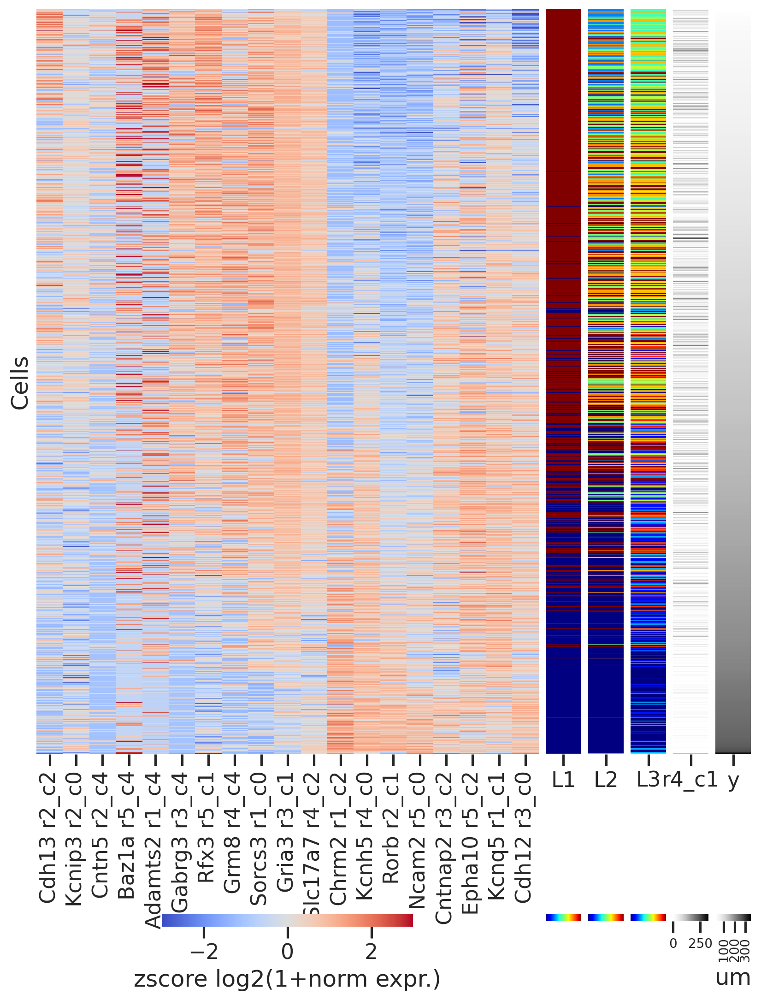

In [49]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*12+"BCDEF")
ax = axd["A"]
col_idx = mat_ftrs.columns[col_order].values.astype(str)
col_names = var_i2n[col_idx].values.astype(str)
xticklabels = np.char.add(np.char.add(col_names, ' '), col_idx)

sns.heatmap(
    mat_ftrs.iloc[row_order,col_order],
    yticklabels=False,
    xticklabels=xticklabels,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+norm expr.)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')
# ax.set_xticklabels()

for i, (ax, col) in enumerate(zip(
    (axd["B"], axd["C"], axd["D"]),
    ('clst_l1', 'clst_l2', 'clst_l3'),
    )):
    # vec = adata3v2.obs[col][row_order].values
    sns.heatmap(
        adata3v2.obs[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label='', ticks=[]),
        ax=ax,
    )
    ax.set_ylabel('')
    # positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    # ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    # for i, pos in enumerate(positions):
    #     ax.text(0, pos, i+1, color='white', fontsize=15)

ax = axd["E"]
g = sns.heatmap(
    mat_prjs.iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, ),
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10)  # Set fontsize to 12 points

ax = axd["F"]
g = sns.heatmap(
    adata3v2.obs[['y']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
colorbar = g.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10, rotation=90)  # Set fontsize to 12 points

# glut vs non-glut

In [50]:
col = var_n2i['Slc17a7']
val = np.array(adata3[:,col].layers['nrm'])

<Axes: ylabel='Count'>

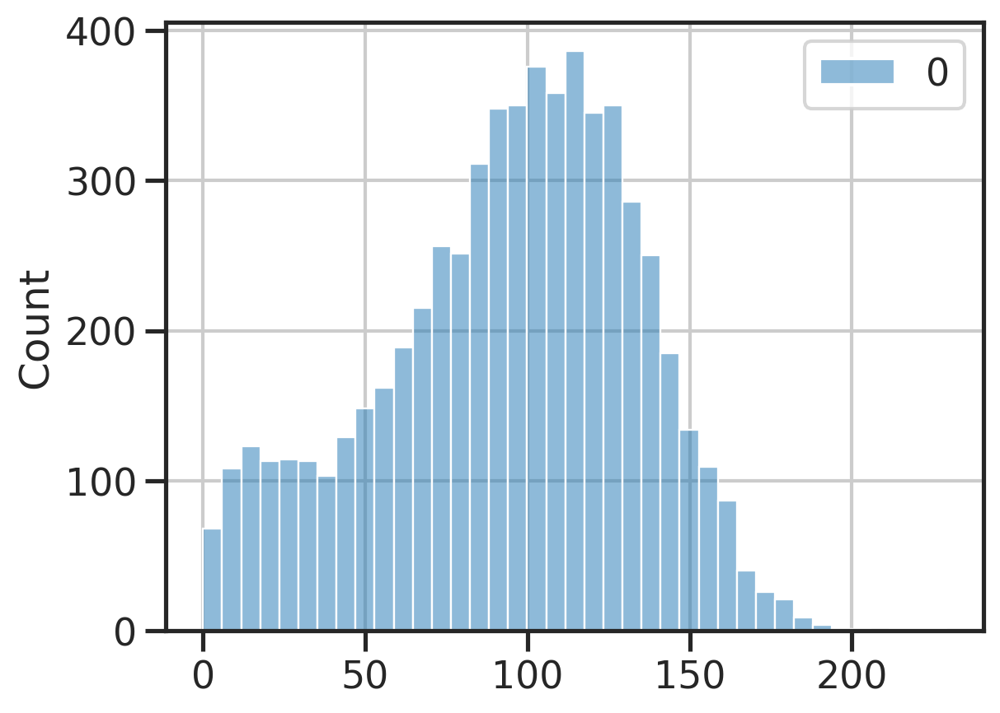

In [51]:
sns.histplot(val)

<Axes: ylabel='Count'>

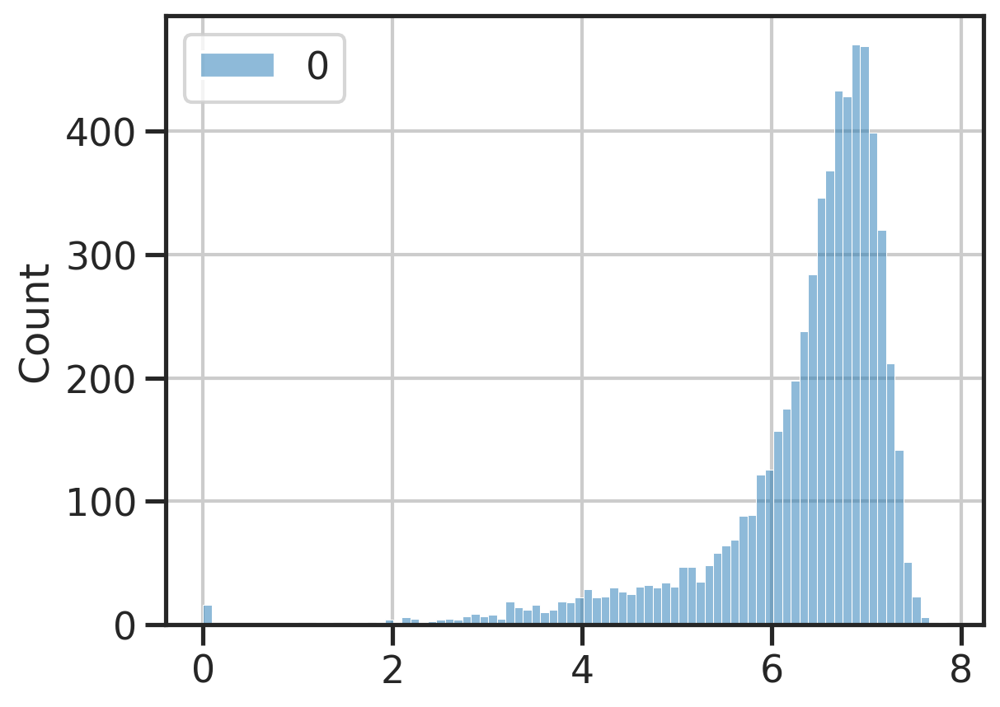

In [52]:
sns.histplot(np.log2(1+val))

<Axes: xlabel='r4_c2', ylabel='Count'>

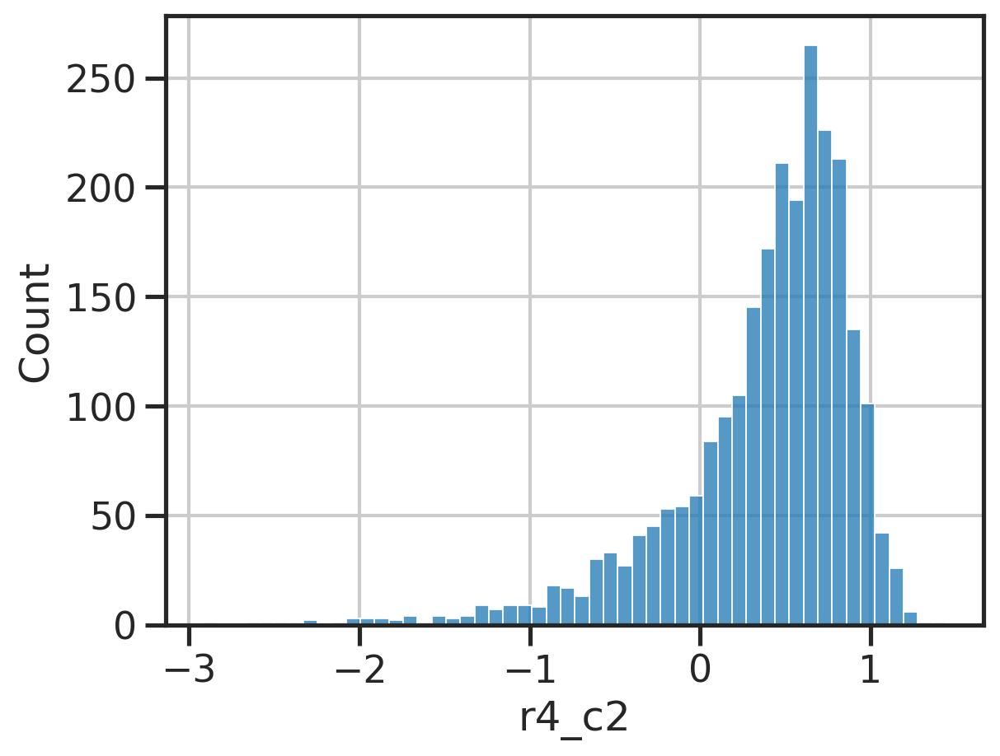

In [53]:
sns.histplot(mat_ftrs[col])

# co-expression, clustering, cluster enrichment of expression

/tmp/ipykernel_103279/89278765.py:26: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col,


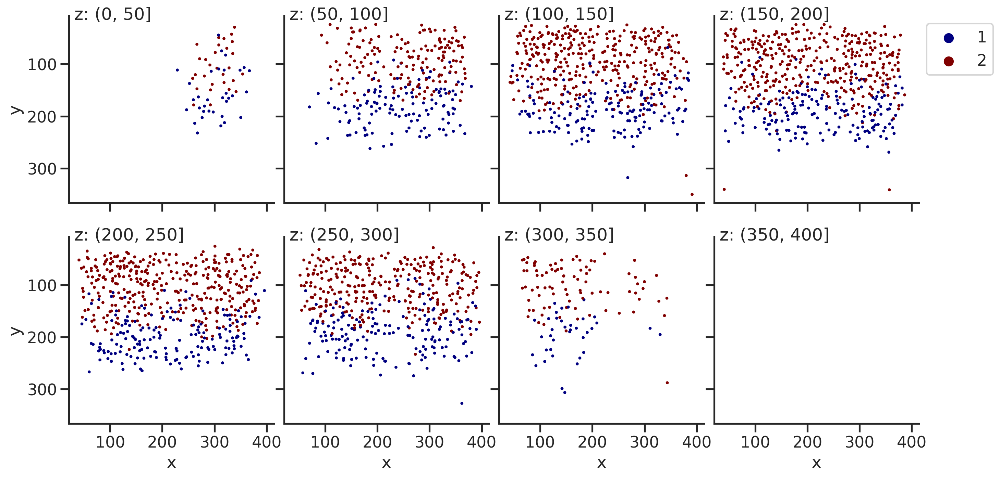

In [54]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l1'
view_z_sections_labels(df_p3v2, sp_x, sp_y, col, palette=palette1, title=None, flip_y=True)

/tmp/ipykernel_103279/89278765.py:26: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col,


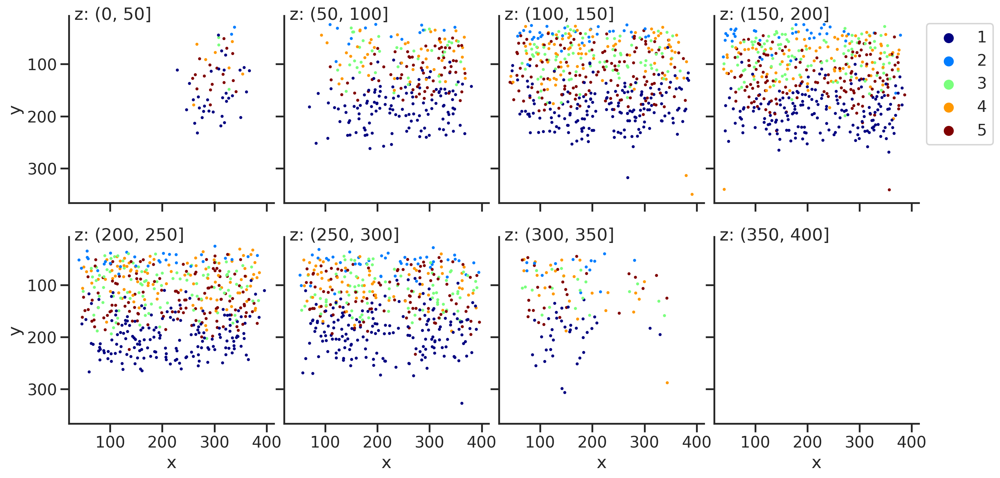

In [55]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l2'
view_z_sections_labels(df_p3v2, sp_x, sp_y, col, palette=palette2, title=None, flip_y=True)

# Order cells by y-axis

# Order cluster and gene heatmap